# Correlation of local densities from neighbor balancing with epigenetics tracks



In [8]:
from neighbor_balance.plotting import format_ticks, parse_region, apply_matplotlib_style, ContactMap, get_epigenetics, get_epigenetics_ylims
from neighbor_balance.smoothing import coarsen_contact_map
from neighbor_balance.neighbor import normalize_contact_map_neighbor, normalize_contact_map_average
import matplotlib.pyplot as plt
import numpy as np

apply_matplotlib_style()

# ENCODE tracks are all signal-p data.
supercloud = '/home/joepaggi/orcd/pool/omics'
tracks = {
    'ATAC': f'{supercloud}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw',

    'POLII': f'{supercloud}/genomics_data/GSM6809981_WT_PolII_xChIP_r2_mm39_MERGED_rmdup_downsampled.bw',
    'RNA-seq': f'{supercloud}/genomics_data/GSE123636_C59_1_2_RNAseq_coverage.mm39.bw',

    'H3K27ac': f'{supercloud}/new_genomics_data/ENCFF230RNU.mm39.bw',
    'H3K4me1': f'{supercloud}/new_genomics_data/ENCFF410CGG.mm39.bw',
    'H3K4me3': f'{supercloud}/new_genomics_data/ENCFF523UIR.mm39.bw',

    'H3K27me3': f'{supercloud}/new_genomics_data/ENCFF160FEV.mm39.bw',
    'H3K9me3': f'{supercloud}/new_genomics_data/ENCFF293DGT.mm39.bw',

    'H1': f'{supercloud}/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw',
    #'RCMC-pileup': f'{supercloud}/../rcmc/nucleosomes_pe/all.nodups.shift73.bw',

    #'CTCF': f'{supercloud}/genomics_data/GSM2418860_WT_CTCF.mm39.bw',
    #'SMC1A': f'{supercloud}/genomics_data/GSM3508477_C59_Smc1a_SpikeInNormalized.mm39.bw',
    #'MED1': f'{supercloud}/genomics_data/GSM560347_10022009_42TM0AAXX_B6.mm39.bw',
    #'RING1B': f'{supercloud}/genomics_data/GSE96107_ES_Ring1B.mm39.bw',
}

regions = ['sox2', 'klf1', 'ppm1g', 'fbn2', 'nanog']
conditions = ['WT_merged']#, 'WT_BR1', 'WT_BR2', 'WT_BR1_with_dups', 'rad21_dmso', 'RAD21_BR1', 'triptolide4h']

In [2]:
maps = {}
for condition in conditions:
    for name in regions:
        print(condition, name)
        loaded = np.load(f'region_contact_maps/{condition}/{name}.npz', allow_pickle=True)
        contact_map = loaded['array']
        metadata = loaded['metadata'].item()
        chrom, start, end = parse_region(metadata['region'])
        if condition not in maps:
            maps[condition] = {}
        maps[condition][name] = {}

        maps[condition][name]['ice'] = ContactMap(normalize_contact_map_average(contact_map.copy()), chrom, start, end, 200)
        maps[condition][name]['neighbor'] = ContactMap(normalize_contact_map_neighbor(contact_map.copy()), chrom, start, end, 200)

WT_merged sox2
WT_merged klf1
WT_merged ppm1g
WT_merged fbn2
WT_merged nanog


# Confirm that smoothing doesn't impact local densities significantly.

In [ ]:
smooth_maps = {}
for condition in maps:
    for name in maps[condition]:
        print(condition, name)
        for balancing in maps[condition][name]:
            if condition not in smooth_maps:
                smooth_maps[condition] = {}
            if name not in smooth_maps[condition]:
                smooth_maps[condition][name] = {}
            contact_map = maps[condition][name][balancing].copy()
            contact_map.contact_map = coarsen_contact_map(contact_map.contact_map)
            smooth_maps[condition][name][balancing] = contact_map

WT_merged sox2
WT_merged klf1
WT_merged ppm1g
WT_merged fbn2
WT_merged nanog


In [4]:
import pandas as pd

rep1 = '/home/joepaggi/orcd/pool/condensibility/GSE252941_E14_NCP_sp_1rep_10kb_score_E14_NCPre3_sp_8_1rep.mm39.bg'
rep2 = '/home/joepaggi/orcd/pool/condensibility/GSE252941_E14_NCP_sp_2rep_10kb_score_E14_NCPre4_sp_8_1rep.mm39.bg'
condensibility1 = pd.read_csv(rep1, sep='\t', header=None, names=['chrom', 'start', 'end', 'score'])
condensibility2 = pd.read_csv(rep2, sep='\t', header=None, names=['chrom', 'start', 'end', 'score'])
condensibility1 = condensibility1.set_index(['chrom', 'start', 'end'])
condensibility2 = condensibility2.set_index(['chrom', 'start', 'end'])
condensibility = condensibility1.join(condensibility2, how='outer', lsuffix='_rep1', rsuffix='_rep2')
condensibility = condensibility.reset_index()

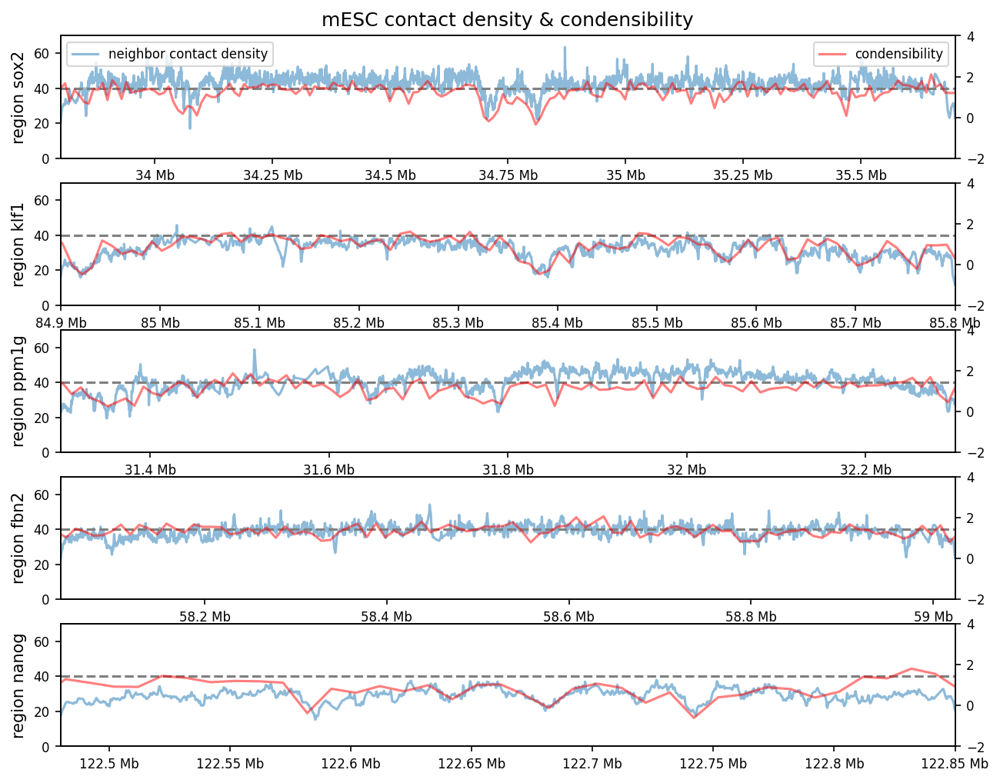

In [ ]:
f, ax = plt.subplots(len(regions), figsize=(10, 8))
tax = [ax[i].twinx() for i in range(len(regions))]
for i, name in enumerate(regions):
    ax[i].set_ylabel(f'region {name}')

    cmap = maps['WT_merged'][name]['neighbor']
    ax[i].plot(cmap.x(), cmap.get_marginal(), label='neighbor contact density', alpha=0.5)

    con = condensibility[condensibility.chrom == cmap.chrom]
    x = (con['start'] + con['end']) / 2
    y = (con['score_rep1'] + con['score_rep2']) / 2
    tax[i].plot(x, y, label='condensibility', c='red', alpha=0.5)
    
    ax[i].set_ylim(0, 70)
    ax[i].axhline(40, c='gray', linestyle='--')
    tax[i].set_ylim(-2, 4)
    ax[i].set_xlim(cmap.start, cmap.end)
    format_ticks(ax[i], y=False, rotate=False)

ax[0].legend(loc='upper left')
tax[0].legend(loc='upper right')
ax[0].set_title('mESC contact density & condensibility')
plt.savefig('img/condensibility_mesc.pdf')
plt.show()

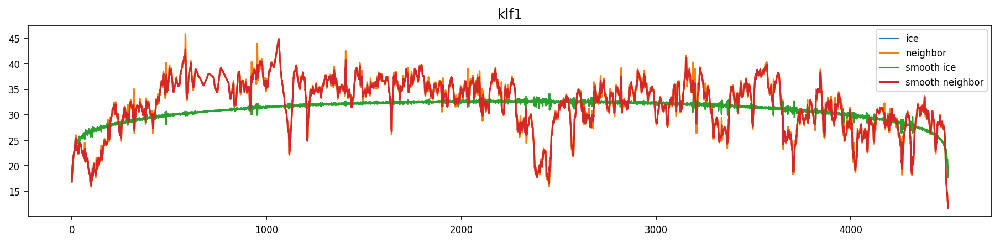

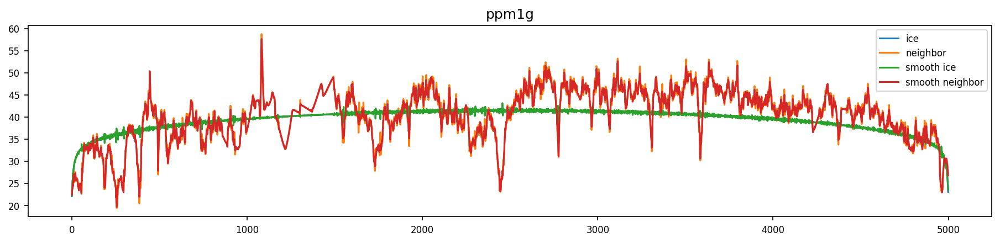

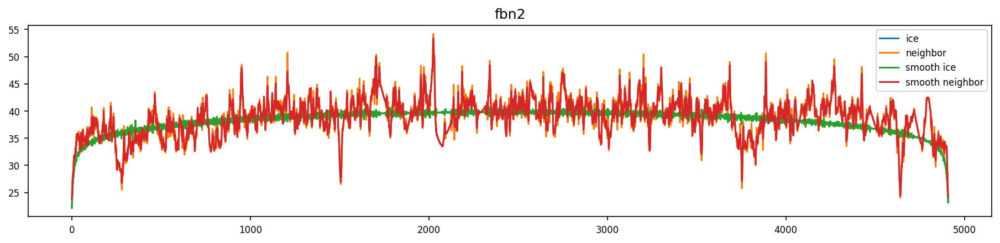

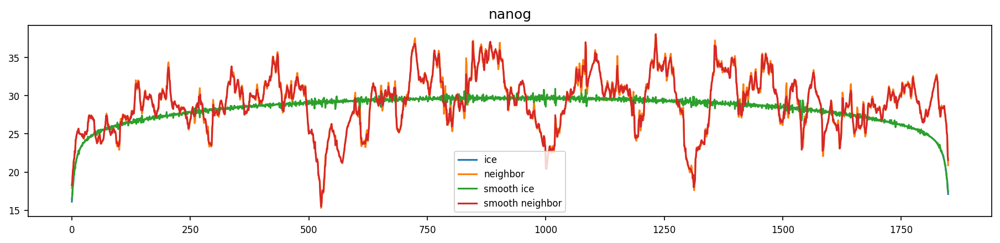

In [ ]:
for name in regions:
    f, ax = plt.subplots(figsize=(15,3))
    plt.plot(maps['WT_merged'][name]['ice'].get_marginal(), label='ice')
    plt.plot(maps['WT_merged'][name]['neighbor'].get_marginal(), label='neighbor')
    plt.plot(smooth_maps['WT_merged'][name]['ice'].get_marginal(), label='smooth ice')
    plt.plot(smooth_maps['WT_merged'][name]['neighbor'].get_marginal(), label='smooth neighbor')
    plt.legend()
    plt.title(name)
    plt.show()

# Compare treatment conditions and replicates

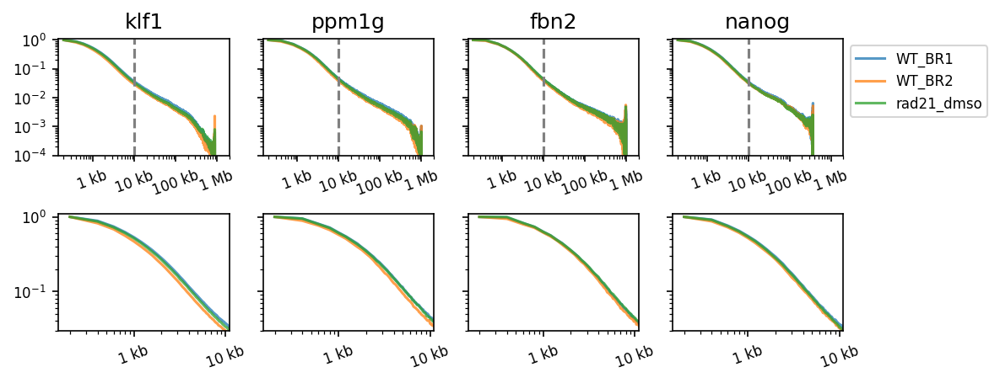

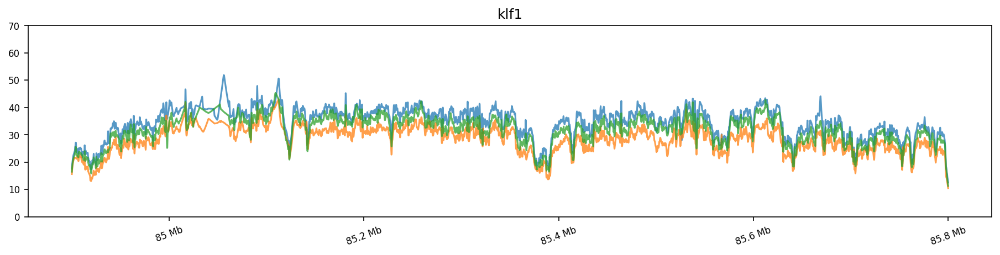

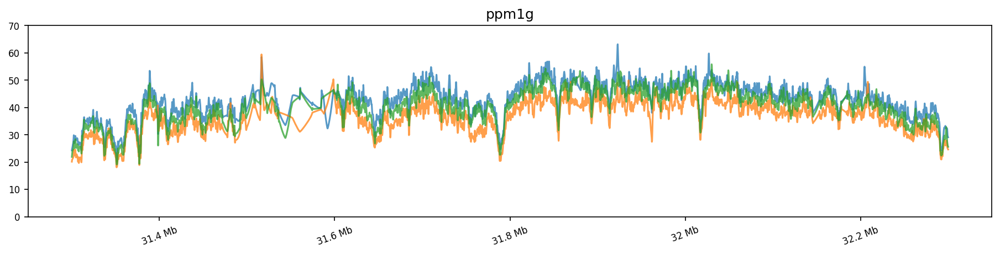

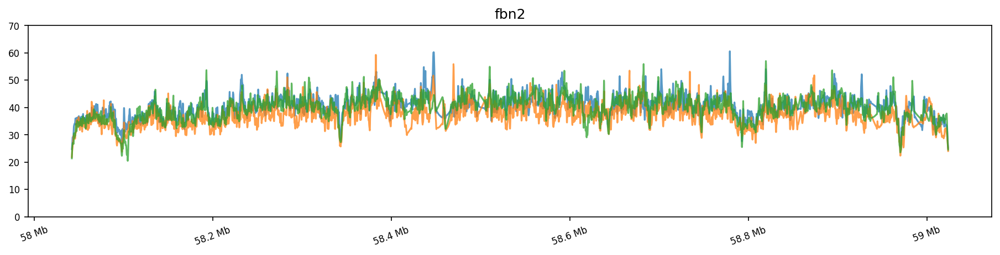

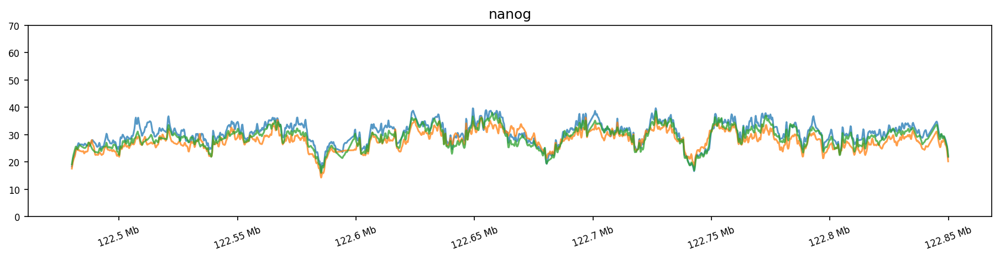

In [7]:
def compare_ps(maps, conditions, regions):
    f, axs = plt.subplots(2, len(regions), figsize=(8, 3.0), sharey='row', gridspec_kw={'hspace': 0.5})
    for i, region in enumerate(regions):
        for ax in axs[:, i]:
            for condition in conditions:
                maps[condition][region]['ice'].plot_distance_average(ax=ax, label=condition, alpha=0.75)

        axs[1, i].set_ylim(0.03, 1.1)
        axs[1, i].set_xlim(150, 11e3)

        axs[0, i].set_title(region)
        axs[0, i].set_ylim(1e-4, 1.1)
        axs[0, i].set_xlim(150, 2e6)
        axs[0, i].axvline(1e4, ls='--', color='gray')
    axs[0, -1].legend(bbox_to_anchor=(1, 1))
    plt.show()

_conditions = ['WT_BR1', 'WT_BR2', 'rad21_dmso']
compare_ps(maps, _conditions, regions)

for name in regions:
    f, ax = plt.subplots(figsize=(15, 3))
    for condition in _conditions:
        contact_map = maps[condition][name]['neighbor']
        ax.plot(contact_map.x(), contact_map.get_marginal(), label=condition, alpha=0.75)
    format_ticks(ax, y=False)
    ax.set_title(name)
    ax.set_ylim(0, 70)
    plt.show()

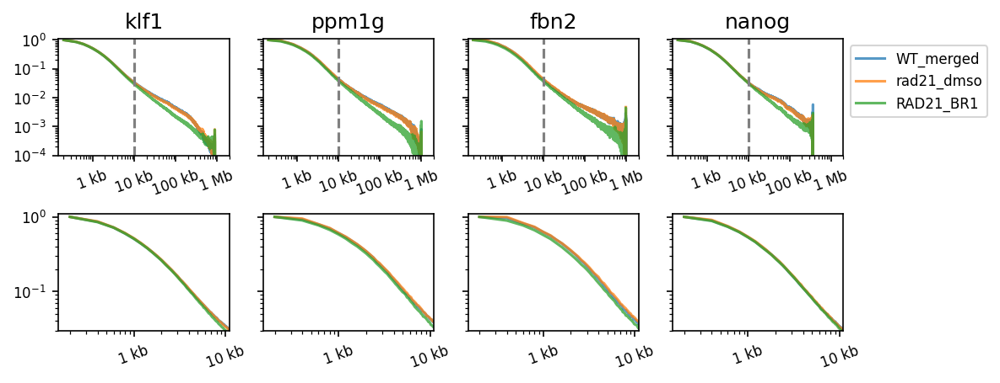

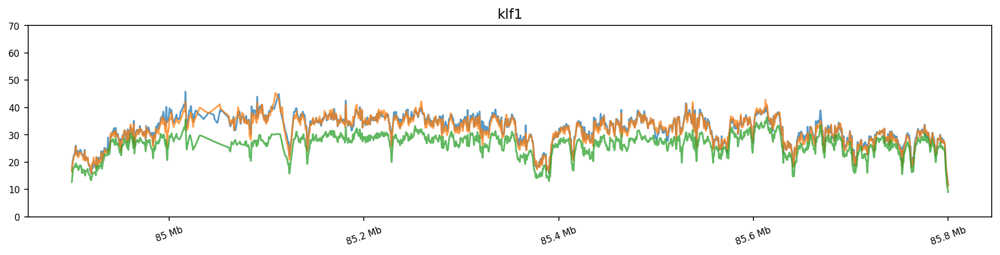

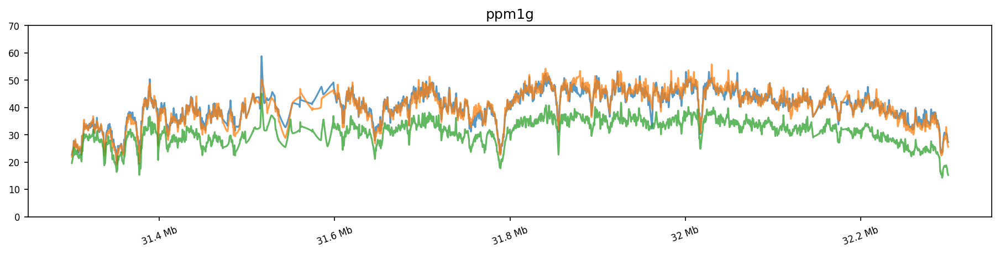

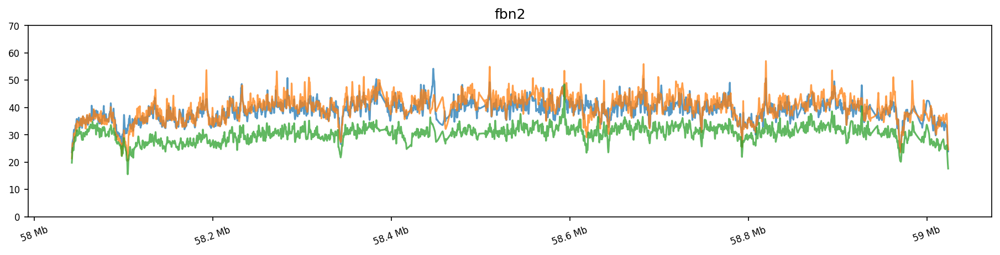

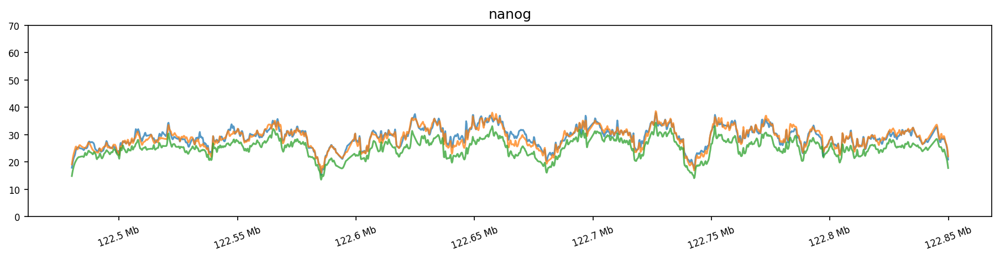

In [8]:
_conditions = ['WT_merged', 'rad21_dmso', 'RAD21_BR1']
compare_ps(maps, _conditions, regions)

for name in regions:
    f, ax = plt.subplots(figsize=(15, 3))
    for condition in _conditions:
        contact_map = maps[condition][name]['neighbor']
        ax.plot(contact_map.x(), contact_map.get_marginal(), label=condition, alpha=0.75)
    format_ticks(ax, y=False)
    ax.set_title(name)
    ax.set_ylim(0, 70)
    plt.show()

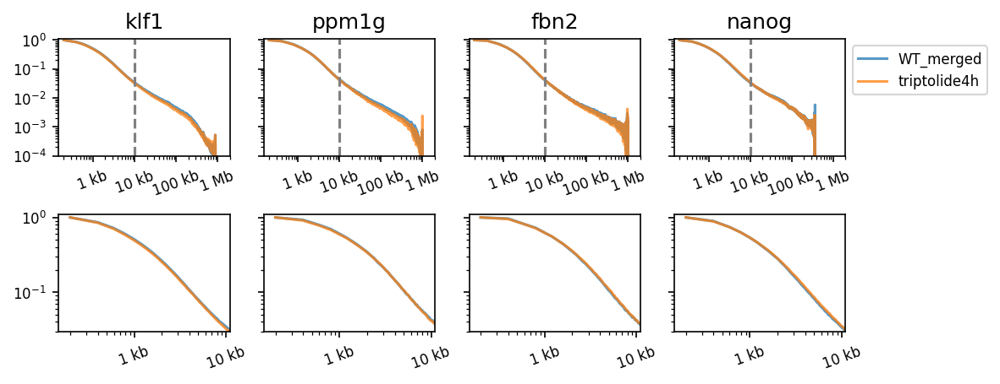

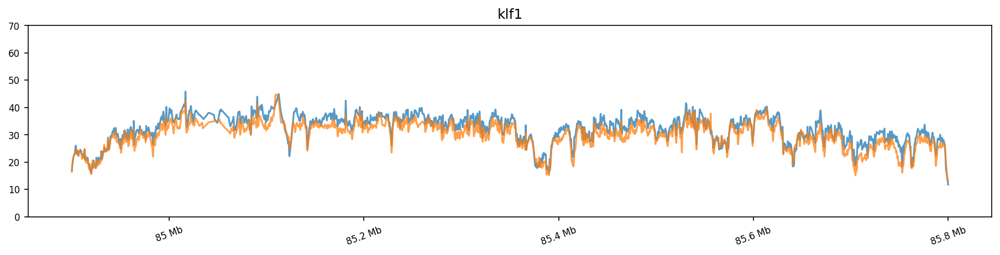

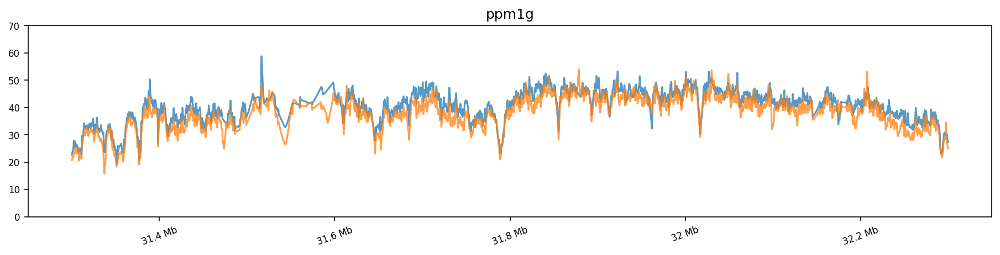

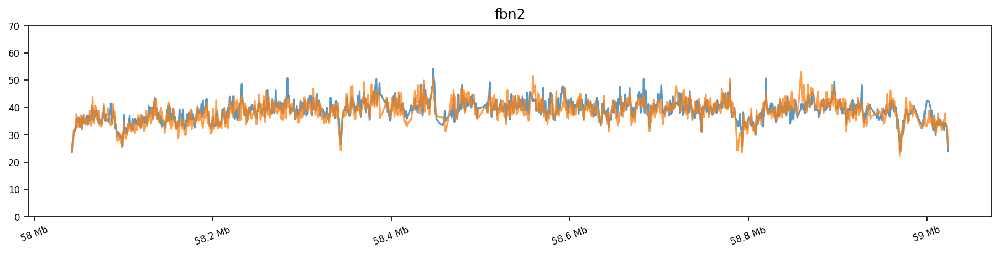

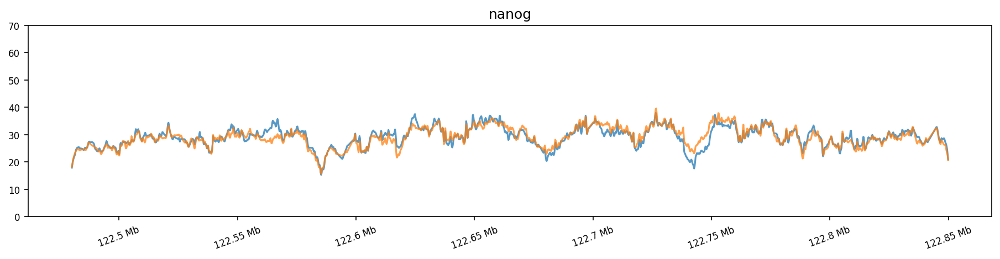

In [9]:
_conditions = ['WT_merged', 'triptolide4h']
compare_ps(maps, _conditions, regions)

for name in regions:
    f, ax = plt.subplots(figsize=(15, 3))
    for condition in _conditions:
        contact_map = maps[condition][name]['neighbor']
        ax.plot(contact_map.x(), contact_map.get_marginal(), label=condition, alpha=0.75)
    format_ticks(ax, y=False)
    ax.set_title(name)
    ax.set_ylim(0, 70)
    plt.show()

## Show all epigenetic tracks, contact maps, and total contacts

{'ATAC': (0, np.float64(1480.7239654541015)), 'H3K27ac': (0, np.float64(183.15846214294433)), 'H3K4me1': (0, np.float64(78.93991390228271)), 'H3K4me3': (0, np.float64(195.79028999328614)), 'Contact\ndensity': (0, 70), 'Condensability': (-1, 3)}
[ 268 1306 1374 4528 5057 5697 6698 7397 8362]


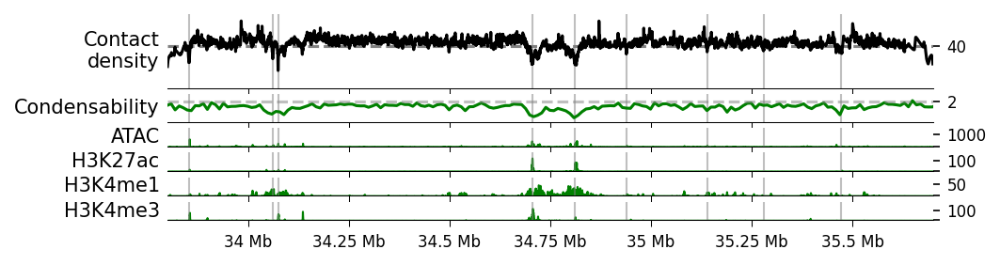

[  98 1118 1211 2446 2572 3328 3704 4022 4263 4314]


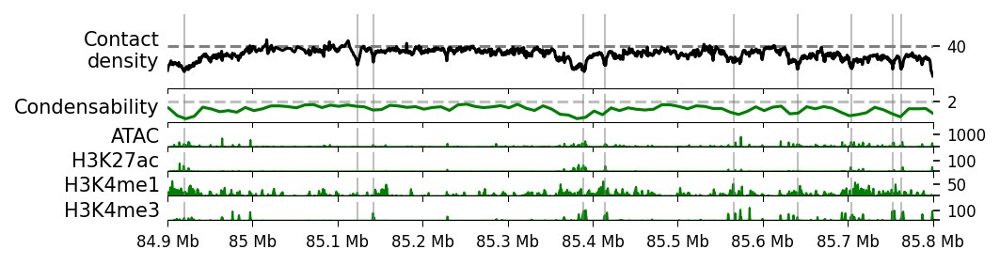

[ 257  385  549 1217 1728 2445 2775 3307 3586]


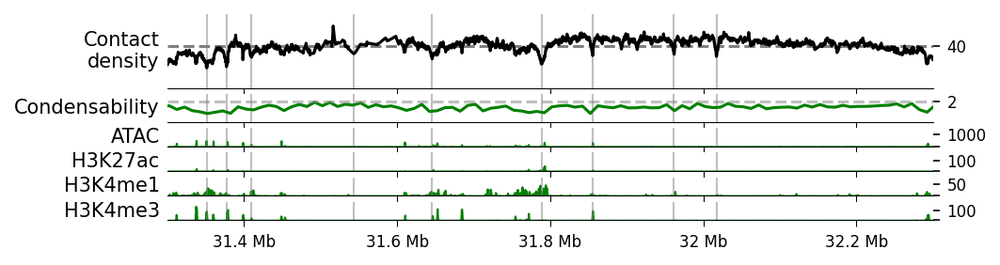

[ 279 1506 2072 3754 4641]


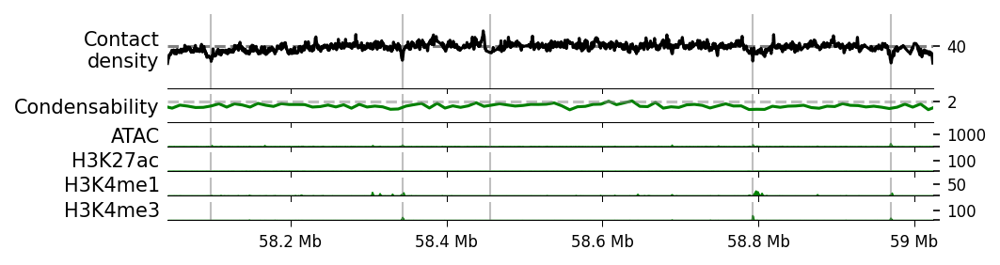

[ 527 1004 1193 1310]


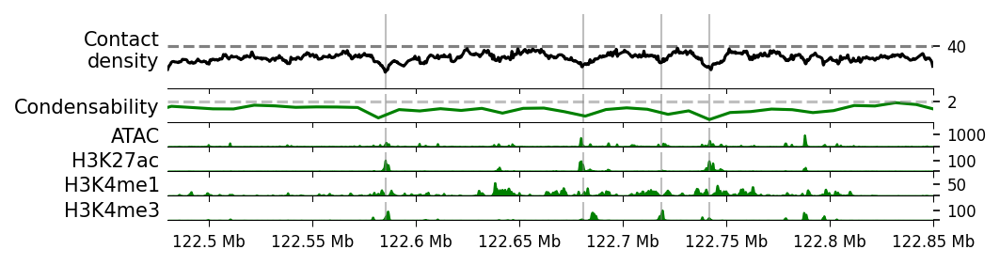

In [6]:
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

def epigenetics_plot(self, tracks, metrics=None, depth=None, vmin=1e-4, smoothing=200, bin=True, show_map=True, ylims=None,
                     contact_height=0.75, width=20, track_height=0.5, mean_density=None, metric_height=0.75):

    if metrics is None:
        metrics = {}

    if depth is None:
        depth = (self.end - self.start) / 3

    if show_map:
        height_ratios = [width * depth / (1.5 * (self.end - self.start))]
        height_ratios += [contact_height]
        height_ratios += [metric_height]*len(metrics)
        height_ratios += [track_height]*len(tracks)
        
        f, axs = plt.subplots(len(height_ratios), 1, figsize=(width, sum(height_ratios)), sharex=True,
                            gridspec_kw={'height_ratios': height_ratios})
        self.plot_contact_map_horizontal(ax=axs[0], depth=depth, vmin=vmin, colorbar=False)
        contact_map_ax = axs[0]
        axs = axs[1:]
    else:
        height_ratios = [contact_height]
        height_ratios += [metric_height]*len(metrics)
        height_ratios += [track_height]*len(tracks)
        f, axs = plt.subplots(len(height_ratios), 1, figsize=(width, sum(height_ratios)), sharex=True,
                            gridspec_kw={'height_ratios': height_ratios})
        contact_map_ax = None

    def format_ylabel(ax, name):
        # ax.set_ylabel(name, rotation=0, ha='left', labelpad=-10,
        #               bbox=dict(facecolor='white', edgecolor='none', alpha=0.5))
        ax.set_ylabel(name, rotation=0, ha='right', va='center')
        ax.yaxis.tick_right()
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        if ylims is not None:
            ax.set_ylim(*ylims[name])
            
    marginal = self.get_marginal()
    peaks, _ = find_peaks(gaussian_filter1d(-np.log2(marginal), 5), prominence=0.4)
    print(peaks)
    for peak in peaks:
        for ax in axs:
            ax.axvline(self.x()[peak], c='gray', lw=1, alpha=0.5)

    axs[0].set_xlim(self.start, self.end)
    format_ticks(axs[0], y=False)

    if mean_density is None:
        mean_density = np.nanmean(marginal)
    axs[0].axhline(mean_density, ls='--', c='grey')
    axs[0].set_yticks([mean_density])
    axs[0].plot(self.x(), marginal, c='black')
    format_ylabel(axs[0], 'Contact\ndensity')

    for i, (name, track) in enumerate(metrics.items()):
        ax = axs[i+1]
        x, vals = track
        ax.plot(x, vals, c='green')
        format_ylabel(ax, name)

    for i, (name, track) in enumerate(tracks.items()):
        ax = axs[i+1+len(metrics)]
        x, vals = get_epigenetics(track, self.chrom, self.start, self.end, smoothing=smoothing, bin=bin)
        ax.fill_between(self.x(), np.zeros(vals.shape), vals, color='green')
        format_ylabel(ax, name)

        ax.set_xlim((self.start, self.end))
        ax.get_yticklabels()[0].set_visible(False)
    return f, axs, contact_map_ax

_tracks = ['ATAC', 'H3K27ac', 'H3K4me1', 'H3K4me3']
_tracks = {track: tracks[track] for track in _tracks}

ylims = get_epigenetics_ylims([maps['WT_merged'][name]['neighbor'] for name in regions], _tracks)
ylims['Contact\ndensity'] = (0, 70)
ylims['Condensability'] = (-1, 3)
print(ylims)

for name in regions:
    cmap = maps['WT_merged'][name]['neighbor']
    con = condensibility[condensibility.chrom == cmap.chrom]
    x = (con['start'] + con['end']) / 2
    y = (con['score_rep1'] + con['score_rep2']) / 2

    f, ax, _ = epigenetics_plot(cmap, _tracks, metrics={'Condensability': (x, y)},
                          show_map=False, width=7, track_height=0.20, contact_height=.8, ylims=ylims, mean_density=40, metric_height=0.3)
    ax[1].axhline(2, c='gray', linestyle='--', alpha=0.5)
    ax[1].set_yticks([2])
    for axis in ax:
        axis.spines['bottom'].set_linewidth(0.5)
        axis.xaxis.set_tick_params(width=0.5)

    plt.savefig(f'img/epigenetics_main_{name}.pdf')
    plt.show()

Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw
{'ATAC': (0, np.float64(1480.7239654541015)), 'POLII': (0, np.float64(1579.555)), 'RNA-seq': (0, np.float64(836.2406536865234)), 'H3K27ac': (0, np.float64(183.15846214294433)), 'H3K4me1': (0, np.float64(78.93991390228271)), 'H3K4me3': (0, np.float64(195.79028999328614)), 'H3K27me3': (0, np.float64(16.577967400550843)), 'H3K9me3': (0, np.float64(5.694260400533676)), 'H1': (0, np.float64(1.2389764070510865)), 'Contact\ndensity': (0, 70), 'Condensability': (-1, 3)}


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:111: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:160: RuntimeWarning: All-NaN slice encountered
  high = max(high, np.nanmax(vals))


[ 268 1306 1374 4528 5057 5697 6698 7397 8362]


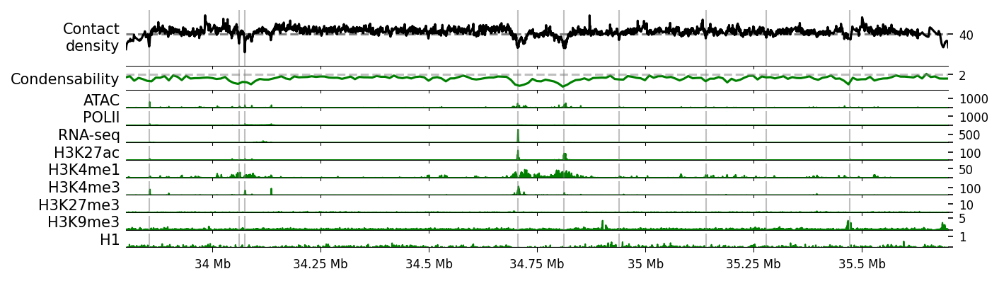

[  98 1118 1211 2446 2572 3328 3704 4022 4263 4314]


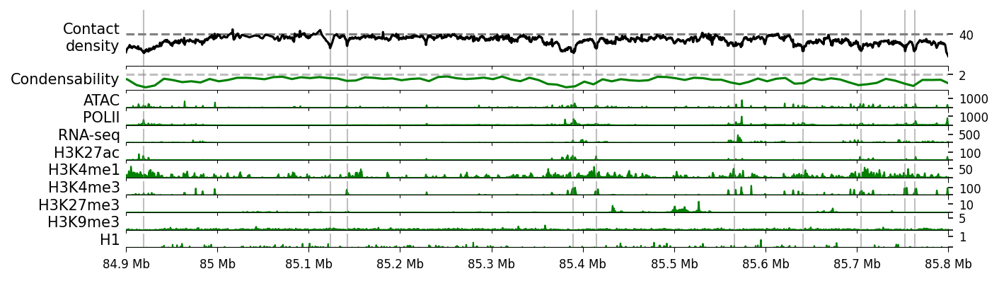

[ 257  385  549 1217 1728 2445 2775 3307 3586]


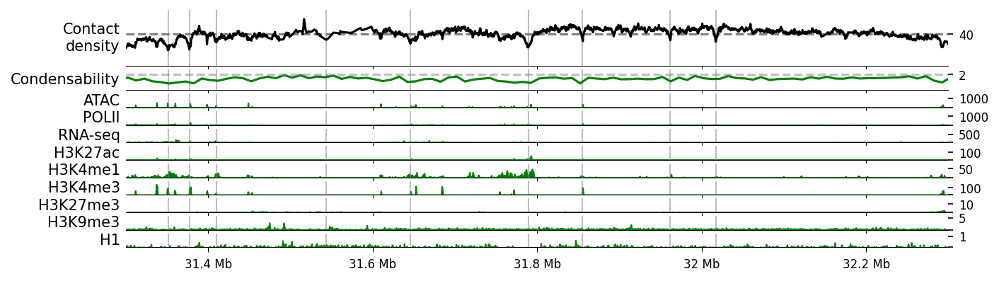

[ 279 1506 2072 3754 4641]
Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:111: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])


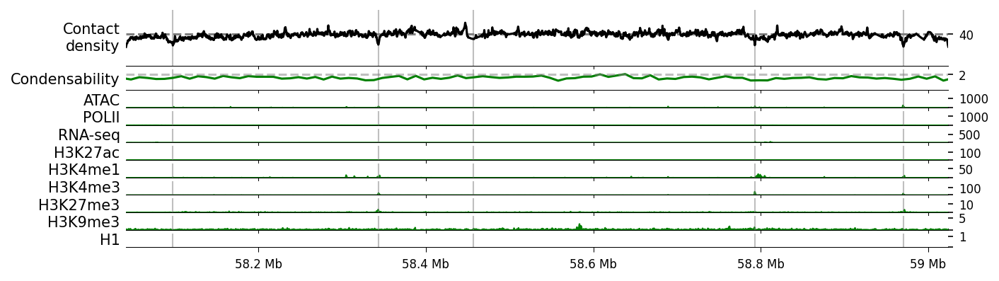

[ 527 1004 1193 1310]


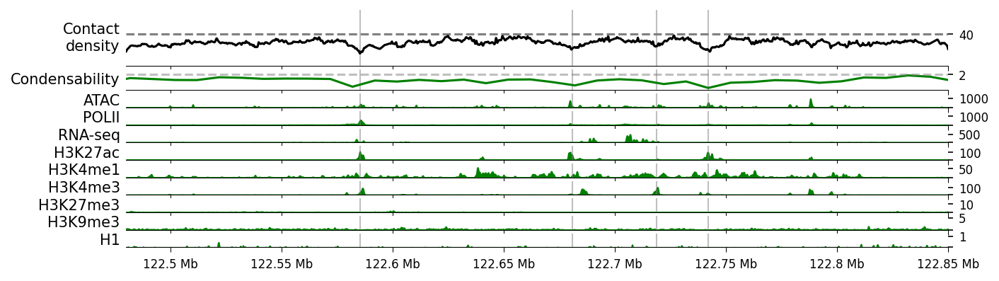

In [9]:
ylims = get_epigenetics_ylims([maps['WT_merged'][name]['neighbor'] for name in regions], tracks)
ylims['Contact\ndensity'] = (0, 70)
ylims['Condensability'] = (-1, 3)
print(ylims)

for name in regions:
    cmap = maps['WT_merged'][name]['neighbor']
    con = condensibility[condensibility.chrom == cmap.chrom]
    x = (con['start'] + con['end']) / 2
    y = (con['score_rep1'] + con['score_rep2']) / 2

    f, ax, _ = epigenetics_plot(cmap, tracks, metrics={'Condensability': (x, y)},
                          show_map=False, width=10, track_height=0.20, contact_height=.8, ylims=ylims, mean_density=40, metric_height=0.3)
    ax[1].axhline(2, c='gray', linestyle='--', alpha=0.5)
    ax[1].set_yticks([2])
    for axis in ax:
        axis.spines['bottom'].set_linewidth(0.5)
        axis.xaxis.set_tick_params(width=0.5)

#     plt.savefig(f'img/epigenetics_main_{name}.pdf')
#     plt.show()

# for name in regions:
#     axs = maps['WT_merged'][name]['neighbor'].epigenetics_plot(tracks, show_map=False, width=10, track_height=0.20, contact_height=.8, ylims=ylims, mean_density=40)
    plt.savefig(f'img/epigenetics_{name}.pdf')
    plt.show()

[  1   2   3   4   5   6   8  10  13  16  20  24  30  38  47  58  72  90
 111 138 171 212 262 325 403 499]


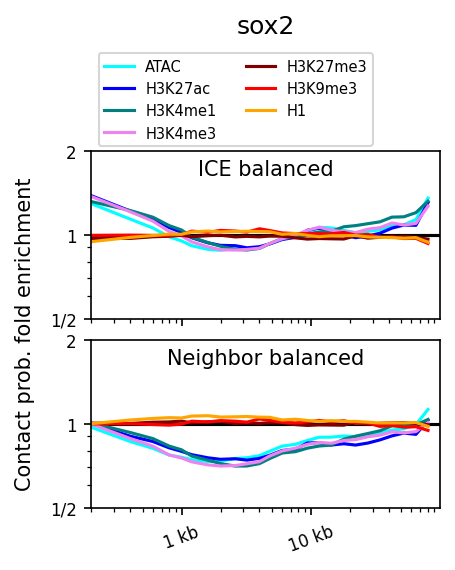

[  1   2   3   4   5   6   8  10  13  16  20  24  30  38  47  58  72  90
 111 138 171 212 262 325 403 499]


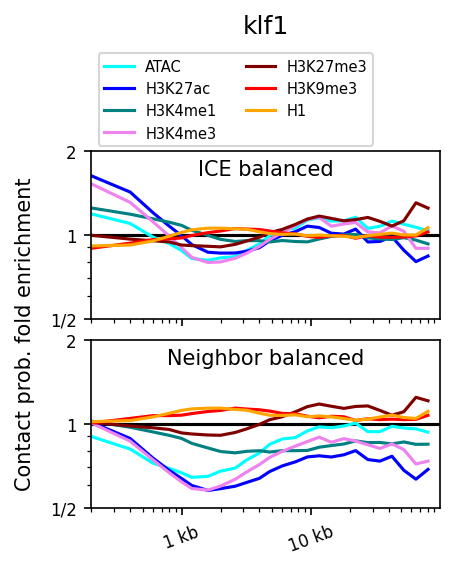

[  1   2   3   4   5   6   8  10  13  16  20  24  30  38  47  58  72  90
 111 138 171 212 262 325 403 499]


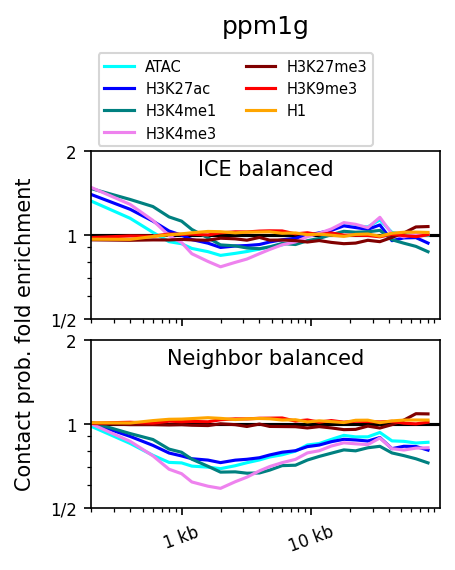

[  1   2   3   4   5   6   8  10  13  16  20  24  30  38  47  58  72  90
 111 138 171 212 262 325 403 499]
Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:107: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:107: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/joepaggi/miniconda3/envs/neighbor/lib/python3.12/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


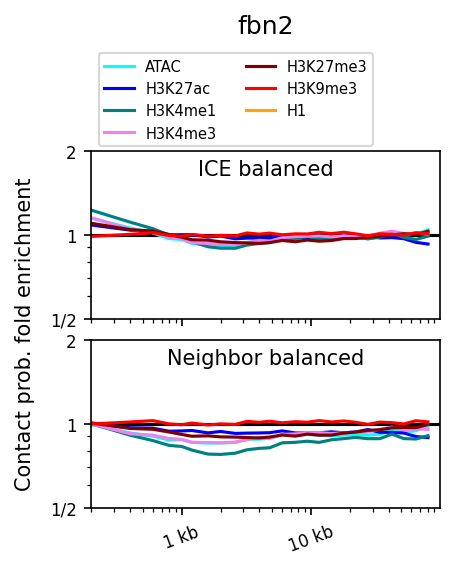

[  1   2   3   4   5   6   8  10  13  16  20  24  30  38  47  58  72  90
 111 138 171 212 262 325 403 499]


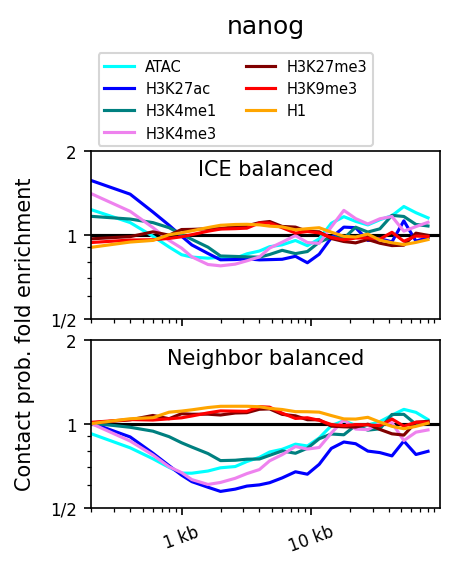

In [ ]:
def plot_locality(cmap, tracks, x=tuple(range(1, 11)), eps=1e-4, scatter=True, log=True, ax=None, colors=None):
    if ax is None:
        f, ax = plt.subplots(figsize=(4, 2.5))
    
    ax.axhline(1, c='k')
    for name, track in tracks.items():
        _, vals = get_epigenetics(track, cmap.chrom, cmap.start, cmap.end, bin=True)

        y = []
        for i in range(len(x) - 1):
            nums, denoms = [], []
            for w in range(x[i], x[i+1]):
                c = np.diagonal(cmap.contact_map, w)
                c = np.nanmean([np.concatenate([c, np.full(w, fill_value=np.nan)]), np.concatenate([np.full(w, fill_value=np.nan), c])], axis=0)
                nums += [c[vals > np.percentile(vals, 95)]]
                denoms += [c[vals < np.percentile(vals, 50)]]
            y += [np.mean(nums) / np.mean(denoms)]

        if colors is not None and name in colors:
            c = colors[name]
        else:
            c = None

        _x = x[:-1]
        ax.plot(200*_x, y, label=name, c=c)
        if scatter:
            ax.scatter(200*_x, y, c=c)

    ax.set_ylim(0.5, 2)
    ax.set_xlim(200*x[0], 200*x[-1])
    
    #ax.set_ylabel('Contact prob. fold enrichment')
    if log:
        ax.set_xscale('log')
        
    ax.set_yscale('log')
    format_ticks(ax, y=False)
    ax.set_yticks([0.5, 1, 2])
    ax.set_yticklabels(['1/2', 1, 2])
    ax.set_yticklabels([], minor=True)
    return ax

_tracks = {
    'ATAC': f'{supercloud}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw',

    'H3K27ac': f'{supercloud}/new_genomics_data/ENCFF230RNU.mm39.bw',
    'H3K4me1': f'{supercloud}/new_genomics_data/ENCFF410CGG.mm39.bw',
    'H3K4me3': f'{supercloud}/new_genomics_data/ENCFF523UIR.mm39.bw',

    'H3K27me3': f'{supercloud}/new_genomics_data/ENCFF160FEV.mm39.bw',
    'H3K9me3': f'{supercloud}/new_genomics_data/ENCFF293DGT.mm39.bw',
    'H1': f'{supercloud}/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw',
}

colors = {
    'ATAC': 'cyan',
    'H3K27ac': 'blue',
    'H3K4me1': 'teal',
    'H3K4me3': 'violet',
    'H3K27me3': 'maroon',
    'H3K9me3': 'red',
    'H1': 'orange',
}

for name in regions:
    f, ax = plt.subplots(3, figsize=(3, 4), gridspec_kw={'height_ratios': [2, 4, 4], 'hspace': 0.15}, sharex='col')
    x = np.unique(np.logspace(0, np.log10(500), 30).astype(int))
    print(x)

    ax[1].text(0.5, 0.95, 'ICE balanced', va='top', ha='center', transform=ax[1].transAxes)
    plot_locality(maps['WT_merged'][name]['ice'], _tracks, x=x,  scatter=False, ax=ax[1], colors=colors)

    ax[2].text(0.5, 0.95, 'Neighbor balanced', va='top', ha='center', transform=ax[2].transAxes)
    plot_locality(maps['WT_merged'][name]['neighbor'], _tracks, x=x, scatter=False, ax=ax[2], colors=colors)

    ax[0].set_title(name)
    h, l = ax[1].get_legend_handles_labels()
    ax[0].legend(h, l, fontsize=7, ncol=2, bbox_to_anchor=(0, 1), loc='upper left')
    ax[0].axis('off')
    f.text(0, 4 / 10, 'Contact prob. fold enrichment', va='center', ha='right', rotation='vertical', fontsize=10)
    plt.savefig(f'img/neighbor_corr_{name}.pdf')
    plt.show()

[  1   2   3   4   5   7   9  11  14  17  21  27  34  42  53  66  82 102
 128 159 199 248 309 385 481 599]


Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:107: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])


Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw
Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:107: RuntimeWarning: Mean of empty slice
  return np.array([np.nanmean(vals[i:i+step]) for i in range(0, len(vals), step)])


Chromosome chr18 not found in /home/joepaggi/orcd/pool/omics/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw


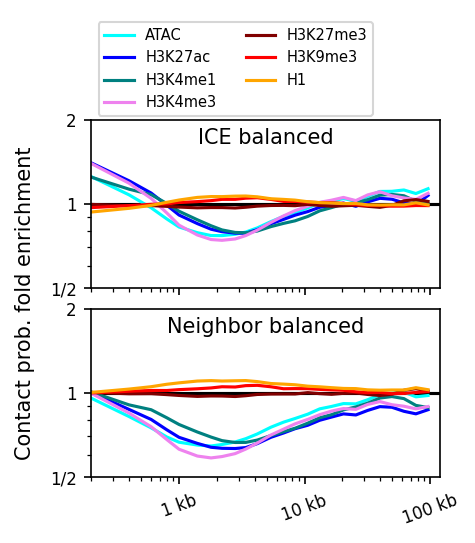

In [5]:
def plot_locality(cmaps, tracks, x=tuple(range(1, 11)), eps=1e-4, scatter=True, log=True, ax=None, colors=None):
    if ax is None:
        f, ax = plt.subplots(figsize=(4, 2.5))


    upper_cutoffs = {}
    lower_cutoffs = {}
    for name, track in tracks.items():
        vals = []
        for cmap in cmaps:
            vals += [get_epigenetics(track, cmap.chrom, cmap.start, cmap.end, bin=True)[1]]
        vals = np.concatenate(vals)
        upper_cutoffs[name] = np.nanpercentile(vals, 95)
        lower_cutoffs[name] = np.nanpercentile(vals, 50)
    
    ax.axhline(1, c='k')
    for name, track in tracks.items():
        nums = [[] for _ in range(len(x) - 1)]
        denoms = [[] for _ in range(len(x) - 1)]
        for cmap in cmaps:
            vals = get_epigenetics(track, cmap.chrom, cmap.start, cmap.end, bin=True)[1]

            for i in range(len(x) - 1):
                for w in range(x[i], x[i+1]):
                    c = np.diagonal(cmap.contact_map, w)
                    c = np.nanmean([np.concatenate([c, np.full(w, fill_value=np.nan)]), np.concatenate([np.full(w, fill_value=np.nan), c])], axis=0)
                    nums[i] += list(c[vals > upper_cutoffs[name]])
                    denoms[i] += list(c[vals < lower_cutoffs[name]])
    
        y = [np.mean(num) / np.mean(denom) for num, denom in zip(nums, denoms)]

        if colors is not None and name in colors:
            c = colors[name]
        else:
            c = None

        _x = x[:-1]
        ax.plot(200*_x, y, label=name, c=c)
        if scatter:
            ax.scatter(200*_x, y, c=c)

    ax.set_ylim(0.5, 2)
    ax.set_xlim(200*x[0], 200*x[-1])
    
    #ax.set_ylabel('Contact prob. fold enrichment')
    if log:
        ax.set_xscale('log')
        
    ax.set_yscale('log')
    format_ticks(ax, y=False)
    ax.set_yticks([0.5, 1, 2])
    ax.set_yticklabels(['1/2', 1, 2])
    ax.set_yticklabels([], minor=True)
    return ax

_tracks = {
    'ATAC': f'{supercloud}/genomics_data/GSE98390_E14_ATAC_MERGED.DANPOS.mm39.bw',

    'H3K27ac': f'{supercloud}/new_genomics_data/ENCFF230RNU.mm39.bw',
    'H3K4me1': f'{supercloud}/new_genomics_data/ENCFF410CGG.mm39.bw',
    'H3K4me3': f'{supercloud}/new_genomics_data/ENCFF523UIR.mm39.bw',

    'H3K27me3': f'{supercloud}/new_genomics_data/ENCFF160FEV.mm39.bw',
    'H3K9me3': f'{supercloud}/new_genomics_data/ENCFF293DGT.mm39.bw',
    'H1': f'{supercloud}/genomics_data/GSM1124783_H1d-1_IP-IN.mm39.bw',
    #'RCMC-pileup': f'{supercloud}/../rcmc/nucleosomes_pe/all.nodups.shift73.bw',

    #'CTCF': f'{supercloud}/genomics_data/GSM2418860_WT_CTCF.mm39.bw',
    #'SMC1A': f'{supercloud}/genomics_data/GSM3508477_C59_Smc1a_SpikeInNormalized.mm39.bw',
    #'MED1': f'{supercloud}/genomics_data/GSM560347_10022009_42TM0AAXX_B6.mm39.bw',
    #'RING1B': f'{supercloud}/genomics_data/GSE96107_ES_Ring1B.mm39.bw',
}

colors = {
    'ATAC': 'cyan',
    'H3K27ac': 'blue',
    'H3K4me1': 'teal',
    'H3K4me3': 'violet',
    'H3K27me3': 'maroon',
    'H3K9me3': 'red',
    'H1': 'orange',
}

f, ax = plt.subplots(3, figsize=(3, 4), gridspec_kw={'height_ratios': [2, 4, 4], 'hspace': 0.15}, sharex='col')
x = np.unique(np.logspace(0, np.log10(600), 30).astype(int))
print(x)

ax[1].text(0.5, 0.95, 'ICE balanced', va='top', ha='center', transform=ax[1].transAxes)
plot_locality([maps['WT_merged'][name]['ice'] for name in regions], _tracks, x=x,  scatter=False, ax=ax[1], colors=colors)

ax[2].text(0.5, 0.95, 'Neighbor balanced', va='top', ha='center', transform=ax[2].transAxes)
plot_locality([maps['WT_merged'][name]['neighbor'] for name in regions], _tracks, x=x, scatter=False, ax=ax[2], colors=colors)

h, l = ax[1].get_legend_handles_labels()
ax[0].legend(h, l, fontsize=7, ncol=2, bbox_to_anchor=(0, 1), loc='upper left')
ax[0].axis('off')
f.text(0, 4 / 10, 'Contact prob. fold enrichment', va='center', ha='right', rotation='vertical', fontsize=10)
plt.savefig(f'img/neighbor_corr.pdf')
plt.show()

# Contact maps with and without neighbor balancing

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


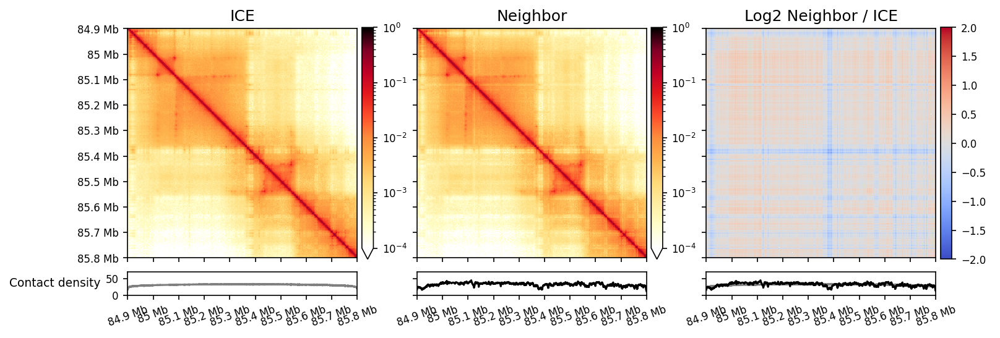

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


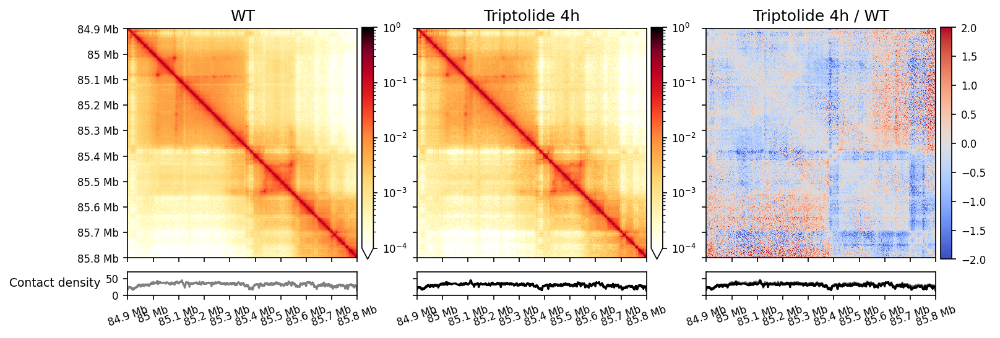

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


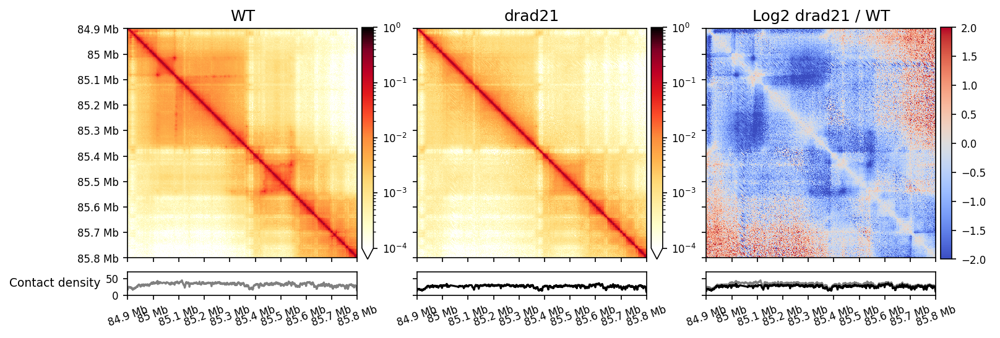

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


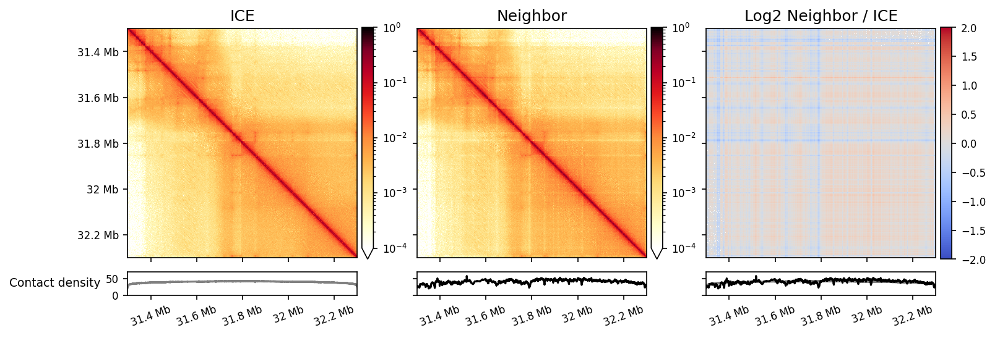

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


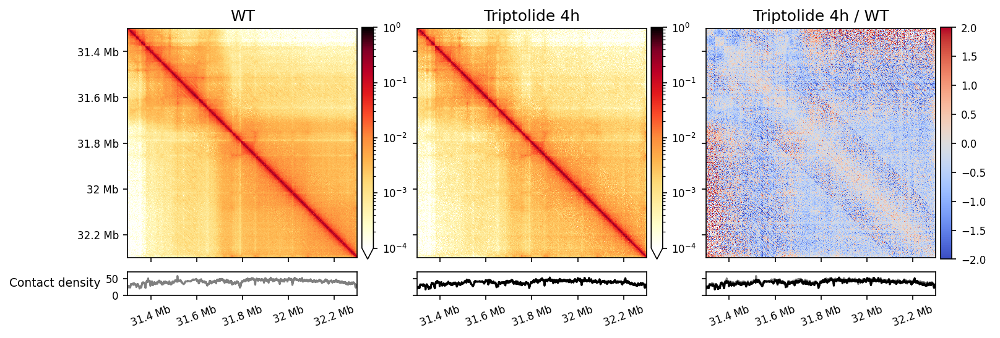

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


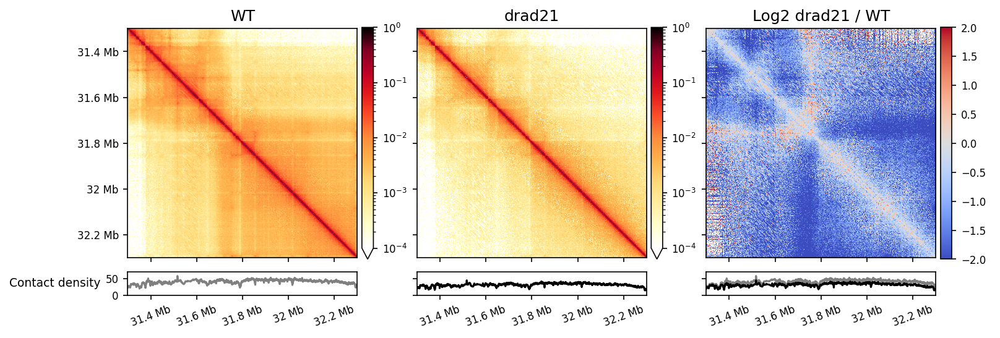

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


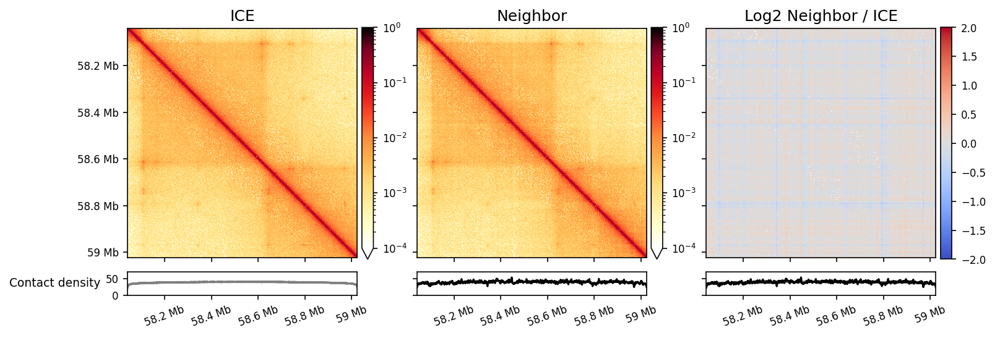

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


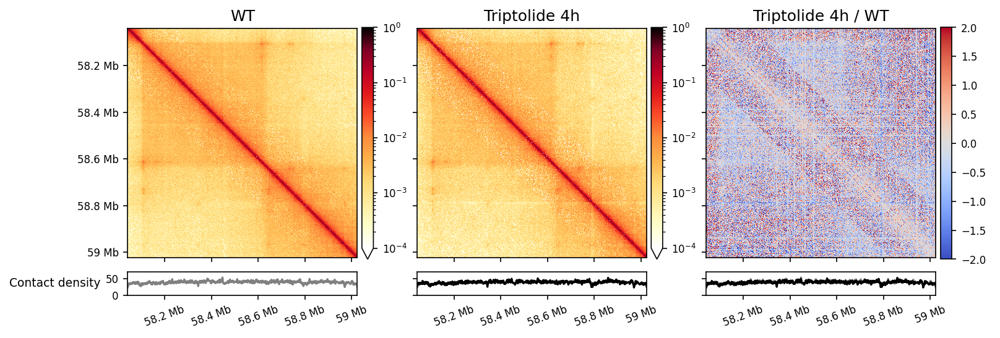

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


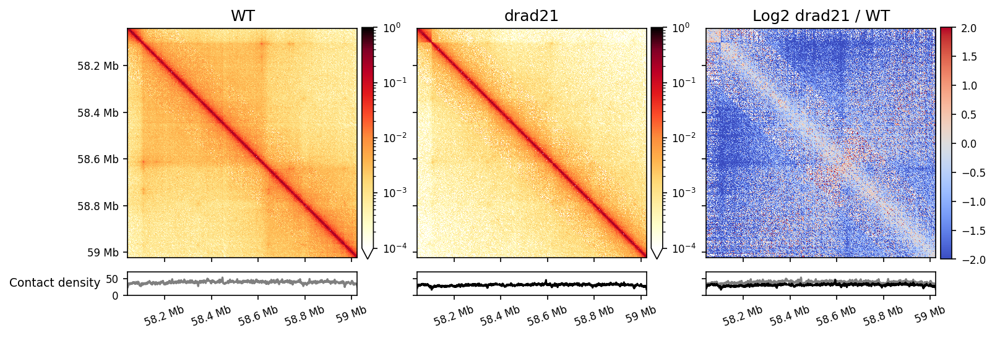

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


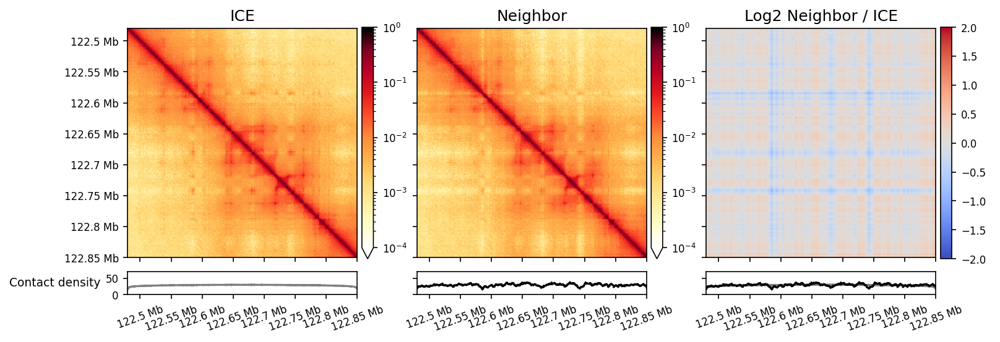

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


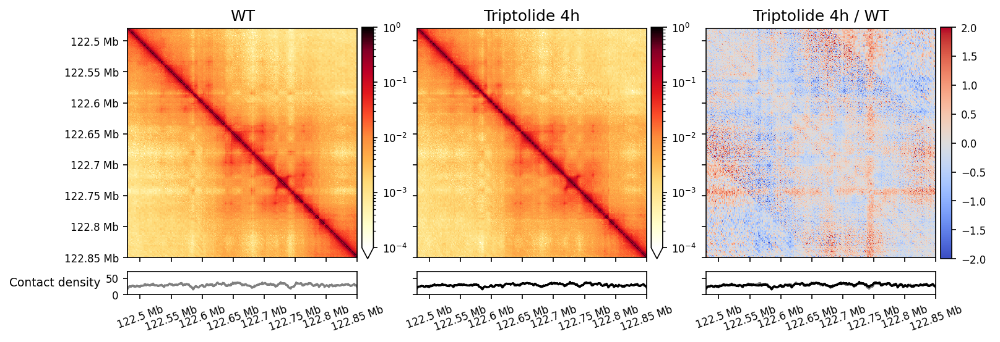

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)
/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:364: RuntimeWarning: divide by zero encountered in log2
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


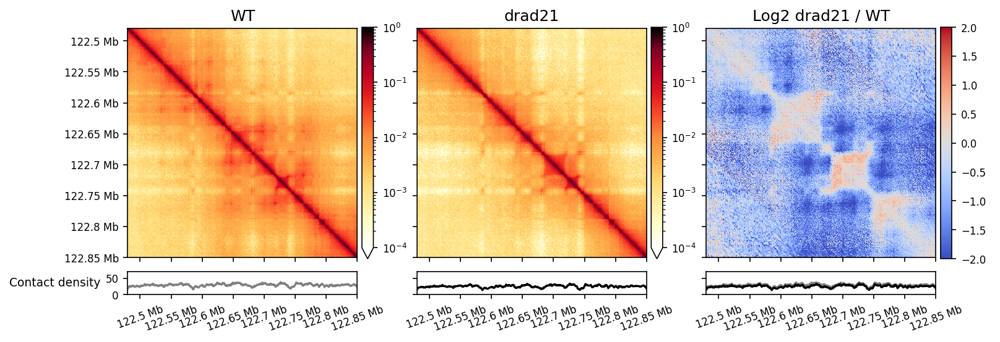

In [13]:
def plot(cmap1, cmap2):
    return cmap2.compare(cmap1, vmin=1e-4, vmax=1e0)

for name in regions:
    cmap_neighbor = smooth_maps['WT_merged'][name]['neighbor']
    cmap_ice = smooth_maps['WT_merged'][name]['ice']
    f, ax = plot(cmap_ice, cmap_neighbor)
    ax[0, 0].set_title('ICE')
    ax[0, 3].set_title('Neighbor')
    ax[0, 6].set_title('Log2 Neighbor / ICE')
    plt.show()


    cmap_neighbor_triptolide = smooth_maps['triptolide4h'][name]['neighbor']
    f, ax = plot(cmap_neighbor, cmap_neighbor_triptolide)
    ax[0, 0].set_title('WT')
    ax[0, 3].set_title('Triptolide 4h')
    ax[0, 6].set_title('Triptolide 4h / WT')
    plt.show()

    cmap_neighbor_rad21 = smooth_maps['RAD21_BR1'][name]['neighbor']
    f, ax = plot(cmap_neighbor, cmap_neighbor_rad21)
    ax[0, 0].set_title('WT')
    ax[0, 3].set_title('drad21')
    ax[0, 6].set_title('Log2 drad21 / WT')
    plt.show()

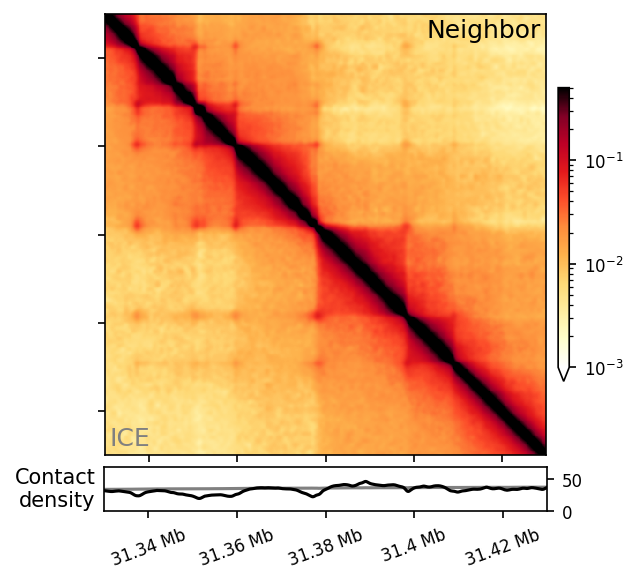

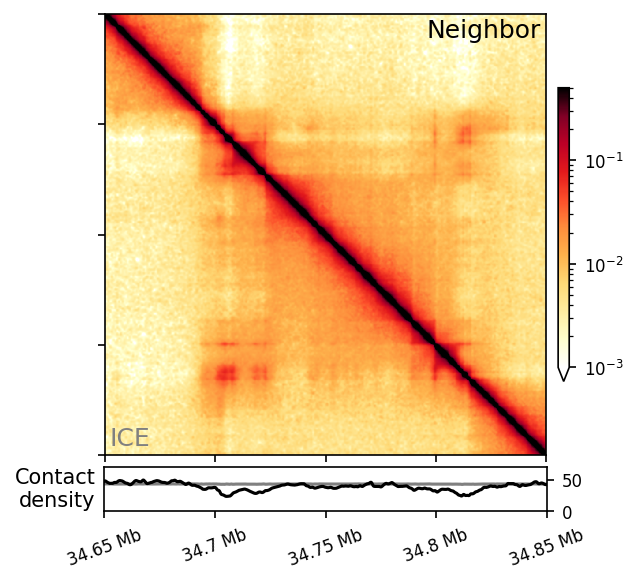

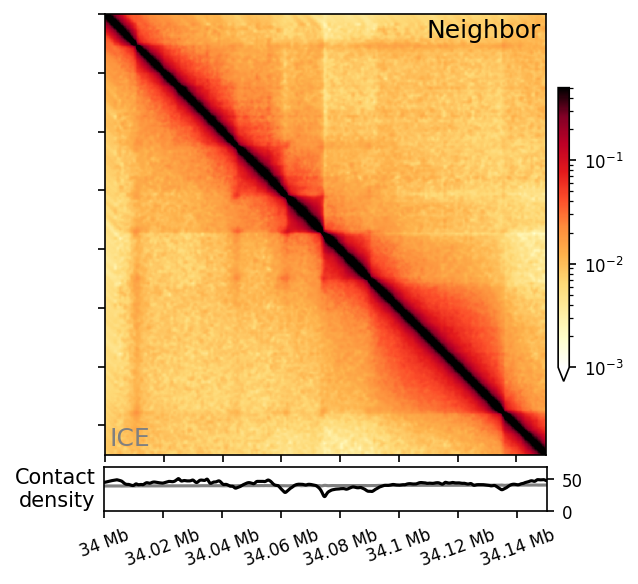

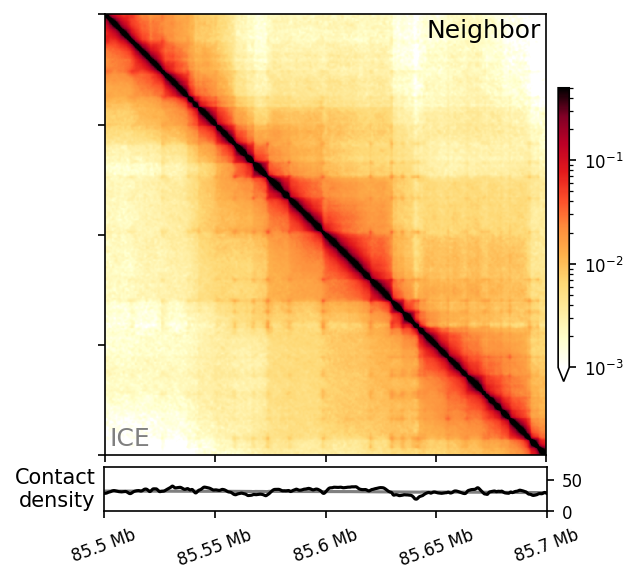

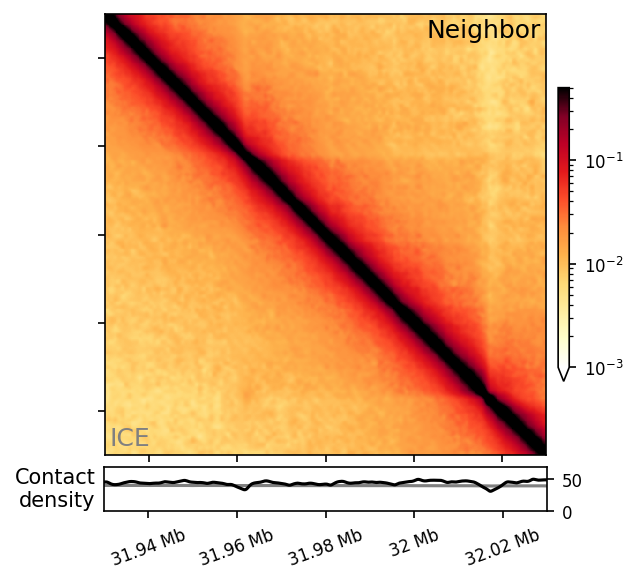

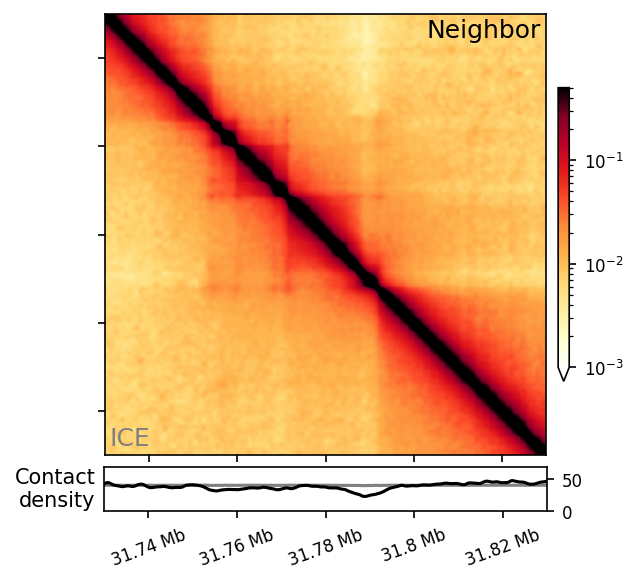

In [71]:
zooms = {'ppm1g zoom': 'chr5:31,330,000-31,430,000',
         'sox2 zoom': 'chr6:34,650,000-34,850,000',
         'sox2 zoom 2': 'chr3:34,000,000-34,150,000',
         'klf1 zoom': 'chr8:85,500,000-85,700,000',
         'ppm1g zoom 2': 'chr5:31,930,000-32,030,000',
         'ppm1g zoom 3': 'chr5:31,730,000-31,830,000',
         }

from scipy.ndimage import gaussian_filter

def compare_on_diagonal(self, other, self_name=None, other_name=None, zoom_start=None, zoom_end=None, vmin=1e-3, vmax=1,
                        log_norm=True, bw=0, density_max=70):
    if (self_name is None) != (other_name is None):
        raise ValueError('Both contact maps must have names or neither can have names.')
    if not self.are_comparable(other):
        raise ValueError('Contact maps are not comparable. They must have the same chromosome and start/end positions.')

    f, ax = plt.subplots(2, 2, figsize=(4, 4.3), sharex='col',
                         gridspec_kw={'wspace': 0.05, 'hspace': 0.05, 'height_ratios': [10, 1], 'width_ratios': [40, 1]})
        

    if bw > 0:
        self = self.copy()
        other = other.copy()
        self.contact_map = gaussian_filter(self.contact_map, bw)
        other.contact_map = gaussian_filter(other.contact_map, bw)
    
    diag_cmap = ContactMap(np.triu(self.contact_map, k=0) + np.tril(other.contact_map, k=-1),
                           start=self.start, end=self.end, chrom=self.chrom, resolution=self.resolution,)
    im = diag_cmap.plot_contact_map(ax=ax[0, 0], vmin=vmin, vmax=vmax, colorbar=False, log_norm=log_norm)
    plt.colorbar(im, cax=ax[0, 1], orientation='vertical', extend='min')
    pos = ax[0, 1].get_position()
    shrink = 2/3
    ax[0, 1].set_position([pos.x0, pos.y0 + pos.height * (1 - shrink) / 2, pos.width, pos.height*shrink])

    ax[1, 0].plot(other.x(), other.get_marginal(), c='gray')
    ax[1, 0].plot(self.x(), self.get_marginal(), c='black')
    ax[1, 0].set_ylabel('Contact\ndensity', rotation=0, ha='right', va='center')
    ax[1, 0].yaxis.tick_right()
    
    if zoom_start is not None:
        ax[0, 0].set_xlim(zoom_start, zoom_end)
        ax[0, 0].set_ylim(zoom_end, zoom_start)
        ax[1, 0].set_xlim(zoom_start, zoom_end)
    format_ticks(ax[1, 0], y=False)
    ax[1, 0].set_ylim(0, density_max)
    ax[1, 1].axis('off')

    if self_name is not None:
        fontsize = 12
        ax[0, 0].text(0.01, 0.01, other_name, transform=ax[0, 0].transAxes, ha='left', va='bottom', fontsize=fontsize, color='gray')
        ax[0, 0].text(0.99, 0.99, self_name, transform=ax[0, 0].transAxes, ha='right', va='top', fontsize=fontsize, color='black')
        
    return f, ax

def plot_real(cmap1, cmap2, name1=None, name2=None):
    return compare_on_diagonal(cmap1, cmap2, zoom_start=start, zoom_end=end, vmin=1e-3, vmax=2e-1, bw=2, log_norm=False,
                               self_name=name1, other_name=name2)

def plot(cmap1, cmap2, name1=None, name2=None):
    return compare_on_diagonal(cmap1, cmap2, zoom_start=start, zoom_end=end, vmin=1e-3, vmax=5e-1, bw=2,
                               self_name=name1, other_name=name2)

for name, region in zooms.items():
    chrom, start, end = parse_region(region)
    full_region_name = name.split(' ')[0]
    if full_region_name not in regions:
        continue

    cmap_neighbor = smooth_maps['WT_merged'][full_region_name]['neighbor']
    cmap_ice = smooth_maps['WT_merged'][full_region_name]['ice']
    f, ax = plot(cmap_neighbor, cmap_ice, name1='Neighbor', name2='ICE')
    ax[0, 0].set_yticklabels([])
    plt.savefig(f'img/neighbor_diagonal_{name.replace(" ", "-")}.pdf')
    plt.show()

    # f, ax = plot_real(cmap_neighbor, cmap_ice, name1='Neighbor', name2='ICE')
    # plt.show()

/orcd/home/002/joepaggi/neighbor-balance/neighbor_balance/plotting.py:365: RuntimeWarning: invalid value encountered in divide
  log_change.contact_map = np.log2(self.contact_map / other.contact_map)


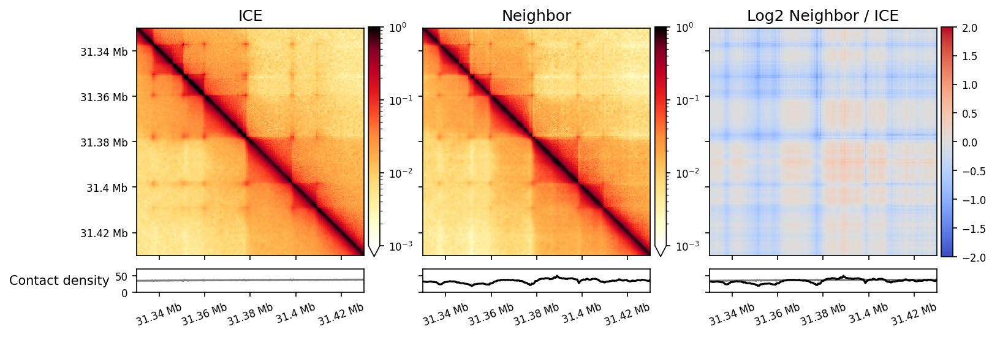

KeyError: 'triptolide4h'

In [68]:
zooms = {'ppm1g zoom': 'chr5:31,330,000-31,430,000',
         'sox2 zoom': 'chr6:34,650,000-34,850,000',
         'sox2 zoom 2': 'chr3:34,000,000-34,150,000',
         'klf1 zoom': 'chr8:85,500,000-85,700,000',
         'ppm1g zoom 2': 'chr5:31,930,000-32,030,000',
         'ppm1g zoom 3': 'chr5:31,730,000-31,830,000',
         }

def plot(cmap1, cmap2):
    return cmap2.compare(cmap1, zoom_start=start, zoom_end=end, vmin=1e-3, bw=2)

for name, region in zooms.items():
    chrom, start, end = parse_region(region)
    full_region_name = name.split(' ')[0]
    if full_region_name not in regions:
        continue

    cmap_neighbor = smooth_maps['WT_merged'][full_region_name]['neighbor']
    cmap_ice = smooth_maps['WT_merged'][full_region_name]['ice']
    f, ax = plot(cmap_ice, cmap_neighbor)
    ax[0, 0].set_title('ICE')
    ax[0, 3].set_title('Neighbor')
    ax[0, 6].set_title('Log2 Neighbor / ICE')
    plt.savefig(f'img/neighbor_{name.replace(' ', '-')}.pdf')
    plt.show()

    cmap_neighbor_triptolide = smooth_maps['triptolide4h'][full_region_name]['neighbor']
    f, ax = plot(cmap_neighbor, cmap_neighbor_triptolide)
    ax[0, 0].set_title('WT')
    ax[0, 3].set_title('Triptolide 4h')
    ax[0, 6].set_title('Triptolide 4h / WT')
    plt.show()

    cmap_neighbor_rad21 = smooth_maps['RAD21_BR1'][full_region_name]['neighbor']
    f, ax = plot(cmap_neighbor, cmap_neighbor_rad21)
    ax[0, 0].set_title('WT')
    ax[0, 3].set_title('drad21')
    ax[0, 6].set_title('Log2 drad21 / WT')
    plt.show()